<a href="https://colab.research.google.com/github/zealtechlab/crack_detection_samples-_new/blob/master/Crack_Detection_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler
from torch.optim import lr_scheduler
from torchvision import datasets, models, transforms
import torchvision
import numpy as np
import os
cwd = os.getcwd()
from PIL import Image
import time
import copy
import random
import cv2
import re
import shutil
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

## Load the Cracks Data set and Visualize it
* Link to the cracks data set:  https://data.mendeley.com/datasets/5y9wdsg2zt/2
* Download the data set and unzip it in the same folder as this notebook

In [3]:
%%time
positive_path = 'content/Positive/'
crack_images = os.listdir(positive_path)
print("Number of Crack Images: ", len(crack_images))

Number of Crack Images:  20000
CPU times: user 11.7 ms, sys: 3.81 ms, total: 15.5 ms
Wall time: 16.4 ms


In [4]:
%%time
negative_path = 'content/Negative/'
no_crack_images = os.listdir(negative_path)
print("Number of No Crack Images: ", len(no_crack_images))

Number of No Crack Images:  20000
CPU times: user 11.2 ms, sys: 2.8 ms, total: 14 ms
Wall time: 14 ms


*****************Random Images with Cracks**************************
CPU times: user 162 ms, sys: 0 ns, total: 162 ms
Wall time: 405 ms


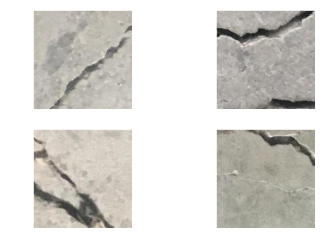

In [5]:
%%time
## Visualize Random images with cracks
random_indices = np.random.randint(0, len(crack_images), size=4)
print("*****************Random Images with Cracks**************************")
random_images = np.array(crack_images)[random_indices.astype(int)]

f, axarr = plt.subplots(2,2)
axarr[0,0].imshow(mpimg.imread(os.path.join(cwd, positive_path, random_images[0])))
axarr[0,1].imshow(mpimg.imread(os.path.join(cwd, positive_path, random_images[1])))
axarr[1,0].imshow(mpimg.imread(os.path.join(cwd, positive_path, random_images[2])))
axarr[1,1].imshow(mpimg.imread(os.path.join(cwd, positive_path, random_images[3])))

*****************Random Images without Cracks**************************
CPU times: user 114 ms, sys: 0 ns, total: 114 ms
Wall time: 118 ms


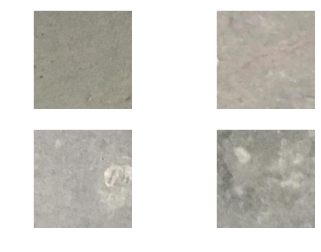

In [6]:
%%time
## Visualize Random images with no cracks
random_indices = np.random.randint(0, len(no_crack_images), size=4)
print("*****************Random Images without Cracks**************************")
random_images = np.array(no_crack_images)[random_indices.astype(int)]

f, axarr = plt.subplots(2,2)
axarr[0,0].imshow(mpimg.imread(os.path.join(cwd, negative_path, random_images[0])))
axarr[0,1].imshow(mpimg.imread(os.path.join(cwd, negative_path, random_images[1])))
axarr[1,0].imshow(mpimg.imread(os.path.join(cwd, negative_path, random_images[2])))
axarr[1,1].imshow(mpimg.imread(os.path.join(cwd, negative_path, random_images[3])))

## Create Train and Val Data sets

### Create training folder

In [7]:
%%time
base_dir = cwd
content_dir = base_dir + '/content'
files = os.listdir(content_dir)

def create_training_data(folder_name):
    train_dir = f"{base_dir}/train/{folder_name}"
    for f in files:
        search_object = re.search(folder_name, f)
        if search_object:
            shutil.move(f'{base_dir}/{folder_name}', train_dir)

CPU times: user 183 µs, sys: 0 ns, total: 183 µs
Wall time: 307 µs


In [8]:
base_dir

'/home/prabhakaran/Documents/ZTL/DL_crack_detection/crack_detection_samples'

In [9]:
%%time
create_training_data('Positive')
create_training_data('Negative')

FileNotFoundError: [Errno 2] No such file or directory: '/home/prabhakaran/Documents/ZTL/DL_crack_detection/crack_detection_samples/Positive'

### Move images randomly from training to val folders

In [10]:
val_positive_path = 'val/Positive'
val_negative_path = 'val/Negative'
os.makedirs(val_positive_path, exist_ok=True)
os.makedirs(val_negative_path, exist_ok=True)

In [11]:
positive_train = base_dir + "/train/Positive/"
positive_val = base_dir + "/val/Positive/"
negative_train = base_dir + "/train/Negative/"
negative_val = base_dir + "/val/Negative/"

positive_files = os.listdir(positive_train)
negative_files = os.listdir(negative_train)

In [12]:
print(len(positive_files), len(negative_files))

15965 16010


In [107]:
for f in positive_files:
    if random.random() > 0.80:
        shutil.move(f'{positive_train}/{f}', positive_val)

In [108]:
for f in negative_files:
    if random.random() > 0.80:
        shutil.move(f'{negative_train}/{f}', negative_val)

## Pytorch data loader and transforms

### Compute mean and std deviation for the dataset

In [13]:
mean_nums = [0.485, 0.456, 0.406]
std_nums = [0.229, 0.224, 0.225]

### PREPROCESS the training images 

In [14]:
%%time
## Define data augmentation and transforms
chosen_transforms = {'train': transforms.Compose([
        transforms.RandomResizedCrop(size=227),
        transforms.RandomRotation(degrees=10),
        transforms.RandomHorizontalFlip(),
        transforms.RandomVerticalFlip(),
        transforms.ColorJitter(brightness=0.15, contrast=0.15),
        transforms.ToTensor(),
        transforms.Normalize(mean_nums, std_nums)
]), 'val': transforms.Compose([
        transforms.Resize(227),
        transforms.CenterCrop(227),
        transforms.ToTensor(),
        transforms.Normalize(mean_nums, std_nums)
]),
}

CPU times: user 60 µs, sys: 0 ns, total: 60 µs
Wall time: 64.4 µs


In [15]:
%%time
## Create the data loader
def load_dataset(format, batch_size):
    data_path = os.path.join(cwd, format)
    dataset = datasets.ImageFolder(
        root=data_path,
        transform= chosen_transforms[format]
    )
    data_loader = DataLoader(
        dataset,
        batch_size=batch_size,
        num_workers=4,
        shuffle=True
    )
    return data_loader, len(dataset), dataset.classes

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 8.11 µs


In [16]:
%%time
## Set code to run on device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cpu
CPU times: user 812 µs, sys: 0 ns, total: 812 µs
Wall time: 862 µs


In [17]:
%%time
train_loader, train_size, class_names = load_dataset('train', 8)
print("Train Data Set size is: ", train_size)
print("Class Names are: ", class_names)
inputs, classes = next(iter(train_loader))
print(inputs.shape, classes.shape)

Train Data Set size is:  31975
Class Names are:  ['Negative', 'Positive']
torch.Size([8, 3, 227, 227]) torch.Size([8])
CPU times: user 134 ms, sys: 69.3 ms, total: 203 ms
Wall time: 1.22 s


### Visualize the Augmented Data Set

In [18]:
# Visualize some images
def imshow(inp, title=None):
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([mean_nums])
    std = np.array([std_nums])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # Pause a bit so that plots are updated

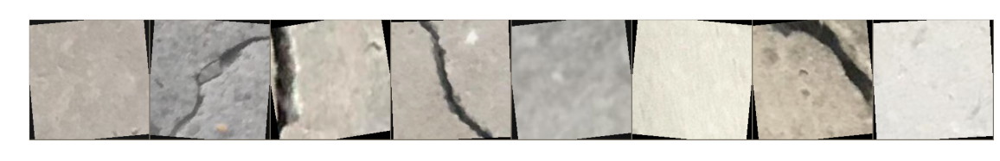

CPU times: user 727 ms, sys: 95.7 ms, total: 823 ms
Wall time: 1.83 s


In [19]:
%%time
# Grab some of the training data to visualize
inputs, classes = next(iter(train_loader))
# class_names = chosen_datasets['train'].classes
# Now we construct a grid from batch
out = torchvision.utils.make_grid(inputs)

idx_to_class = {0:'Negative', 1:'Positive'}
plt.figure(figsize=(20,10))
imshow(out, title=[x.data.numpy() for x in classes])

## Set up Pretrained Model

ResNet-18 model from [“Deep Residual Learning for Image Recognition”](https://arxiv.org/pdf/1512.03385.pdf) cited from [here](https://arxiv.org/abs/1512.03385)

In [20]:
%%time
## Load pretrained model
resnet50 = models.resnet50(pretrained=True)

# Freeze model parameters
for param in resnet50.parameters():
    param.requires_grad = False

## Change the final layer of the resnet model
# Change the final layer of ResNet50 Model for Transfer Learning
fc_inputs = resnet50.fc.in_features
 
resnet50.fc = nn.Sequential(
    nn.Linear(fc_inputs, 128),
    nn.ReLU(),
    nn.Dropout(0.4),
    nn.Linear(128, 2)
)

# Convert model to be used on GPU
resnet50 = resnet50.to(device)

from torchsummary import summary
print(summary(resnet50, (3, 227, 227)))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 114, 114]           9,408
       BatchNorm2d-2         [-1, 64, 114, 114]             128
              ReLU-3         [-1, 64, 114, 114]               0
         MaxPool2d-4           [-1, 64, 57, 57]               0
            Conv2d-5           [-1, 64, 57, 57]           4,096
       BatchNorm2d-6           [-1, 64, 57, 57]             128
              ReLU-7           [-1, 64, 57, 57]               0
            Conv2d-8           [-1, 64, 57, 57]          36,864
       BatchNorm2d-9           [-1, 64, 57, 57]             128
             ReLU-10           [-1, 64, 57, 57]               0
           Conv2d-11          [-1, 256, 57, 57]          16,384
      BatchNorm2d-12          [-1, 256, 57, 57]             512
           Conv2d-13          [-1, 256, 57, 57]          16,384
      BatchNorm2d-14          [-1, 256,

In [21]:
%%time
# Define Optimizer and Loss Function
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(resnet50.parameters())
# optimizer = optim.SGD(resnet50.fc.parameters(), lr=0.001, momentum=0.9)
# Decay LR by a factor of 0.1 every 3 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

CPU times: user 896 µs, sys: 0 ns, total: 896 µs
Wall time: 902 µs


In [22]:
%%time
dataloaders = {}
dataset_sizes = {}
batch_size = 256
dataloaders['train'], dataset_sizes['train'], class_names = load_dataset('train', batch_size)
dataloaders['val'], dataset_sizes['val'], _ = load_dataset('val', batch_size)
idx_to_class = {0:'Negative', 1:'Positive'}

CPU times: user 104 ms, sys: 20 ms, total: 124 ms
Wall time: 124 ms


## Start training

In [23]:
def train_model(model, criterion, optimizer, scheduler, num_epochs=10):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                scheduler.step()
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            current_loss = 0.0
            current_corrects = 0

            # Here's where the training happens
            print('Iterating through data...')

            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                # We need to zero the gradients, don't forget it
                optimizer.zero_grad()

                # Time to carry out the forward training poss
                # We only need to log the loss stats if we are in training phase
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()
                        

                # We want variables to hold the loss statistics
                current_loss += loss.item() * inputs.size(0)
                current_corrects += torch.sum(preds == labels.data)

            epoch_loss = current_loss / dataset_sizes[phase]
            epoch_acc = current_corrects.double() / dataset_sizes[phase]

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))

            # Make a copy of the model if the accuracy on the validation set has improved
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_since = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_since // 60, time_since % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # Now we'll load in the best model weights and return it
    model.load_state_dict(best_model_wts)
    return model


In [24]:
def visualize_model(model, num_images=6):
    was_training = model.training
    model.eval()
    images_handeled = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_handeled += 1
                ax = plt.subplot(num_images//2, 2, images_handeled)
                ax.axis('off')
                ax.set_title('predicted: {}'.format(class_names[preds[j]]))
                imshow(inputs.cpu().data[j])

                if images_handeled == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

Epoch 0/5
----------
Iterating through data...
train Loss: 0.3677 Acc: 0.8495
Iterating through data...
val Loss: 0.1047 Acc: 0.9741

Epoch 1/5
----------
Iterating through data...
train Loss: 0.2062 Acc: 0.9247
Iterating through data...
val Loss: 0.0613 Acc: 0.9832

Epoch 2/5
----------
Iterating through data...
train Loss: 0.1752 Acc: 0.9359
Iterating through data...
val Loss: 0.0559 Acc: 0.9837

Epoch 3/5
----------
Iterating through data...
train Loss: 0.1731 Acc: 0.9363
Iterating through data...
val Loss: 0.0546 Acc: 0.9838

Epoch 4/5
----------
Iterating through data...
train Loss: 0.1744 Acc: 0.9377
Iterating through data...
val Loss: 0.0526 Acc: 0.9847

Epoch 5/5
----------
Iterating through data...
train Loss: 0.1732 Acc: 0.9375
Iterating through data...
val Loss: 0.0523 Acc: 0.9848

Training complete in 1216m 3s
Best val Acc: 0.984798


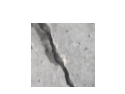

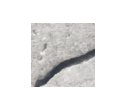

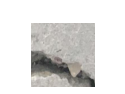

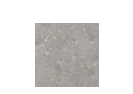

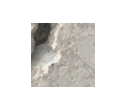

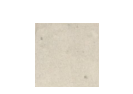

CPU times: user 2d 5h 32min 35s, sys: 4h 24min 58s, total: 2d 9h 57min 33s
Wall time: 20h 17min 4s


In [25]:
%%time
base_model = train_model(resnet50, criterion, optimizer, exp_lr_scheduler, num_epochs=6)
visualize_model(base_model)
plt.show()

### Save/Load state_dict (Recommended)

[Reference](https://pytorch.org/tutorials/beginner/saving_loading_models.html)

#### Save:

torch.save(model.state_dict(), PATH)

#### Load:

model = TheModelClass(*args, **kwargs)

model.load_state_dict(torch.load(PATH))

model.eval()

### Save/Load Entire Model

#### Save:

torch.save(model, PATH)

#### Load:

model = torch.load(PATH)

model.eval()


In [27]:
# Save the model
type(base_model)

torchvision.models.resnet.ResNet

In [29]:
%%time
torch.save(base_model.state_dict(), "model/resnet50_cpu_20200908160640")

CPU times: user 21.3 ms, sys: 44.3 ms, total: 65.6 ms
Wall time: 204 ms


In [31]:
%%time
# Save the entire model
torch.save(base_model, "model/full_resnet50_cpu_20200908160640")

CPU times: user 69.8 ms, sys: 101 ms, total: 171 ms
Wall time: 1.4 s


## Inference

In [32]:
def predict(model, test_image, print_class = False):
     
    transform = chosen_transforms['val']
     
    test_image_tensor = transform(test_image)
 
    if torch.cuda.is_available():
        test_image_tensor = test_image_tensor.view(1, 3, 227, 227).cuda()
    else:
        test_image_tensor = test_image_tensor.view(1, 3, 227, 227)
     
    with torch.no_grad():
        model.eval()
        # Model outputs log probabilities
        out = model(test_image_tensor)
        ps = torch.exp(out)
        topk, topclass = ps.topk(1, dim=1)
        class_name = idx_to_class[topclass.cpu().numpy()[0][0]]
        if print_class:
            print("Output class :  ", class_name)
    return class_name

In [33]:
def predict_on_crops(input_image, height=227, width=227, save_crops = False):
    im = cv2.imread(input_image)
    imgheight, imgwidth, channels = im.shape
    k=0
    output_image = np.zeros_like(im)
    for i in range(0,imgheight,height):
        for j in range(0,imgwidth,width):
            a = im[i:i+height, j:j+width]
            ## discard image cropss that are not full size
            predicted_class = predict(base_model,Image.fromarray(a))
            ## save image
            file, ext = os.path.splitext(input_image)
            image_name = file.split('/')[-1]
            folder_name = 'out_' + image_name
            ## Put predicted class on the image
            if predicted_class == 'Positive':
                color = (0,0, 255)
            else:
                color = (0, 255, 0)
            cv2.putText(a, predicted_class, (50,50), cv2.FONT_HERSHEY_SIMPLEX , 0.7, color, 1, cv2.LINE_AA) 
            b = np.zeros_like(a, dtype=np.uint8)
            b[:] = color
            add_img = cv2.addWeighted(a, 0.9, b, 0.1, 0)
            ## Save crops
            if save_crops:
                if not os.path.exists(os.path.join('real_images', folder_name)):
                    os.makedirs(os.path.join('real_images', folder_name))
                filename = os.path.join('real_images', folder_name,'img_{}.png'.format(k))
                cv2.imwrite(filename, add_img)
            output_image[i:i+height, j:j+width,:] = add_img
            k+=1
    ## Save output image
    cv2.imwrite(os.path.join('real_images','predictions', folder_name+ '.jpg'), output_image)
    return output_image

CPU times: user 2.91 s, sys: 718 ms, total: 3.63 s
Wall time: 1.83 s


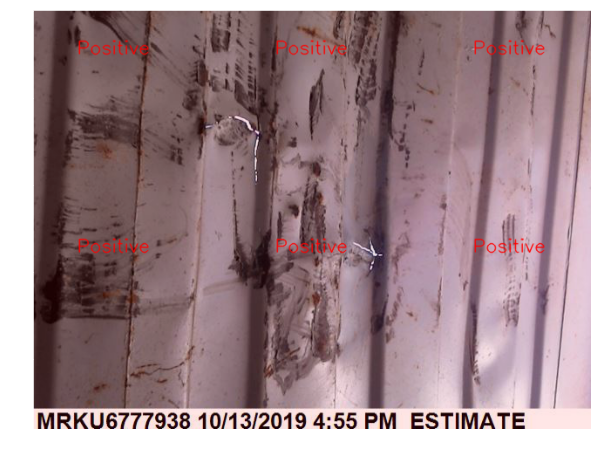

In [35]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_10.jpg')
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 6.48 s, sys: 1.68 s, total: 8.16 s
Wall time: 5.32 s


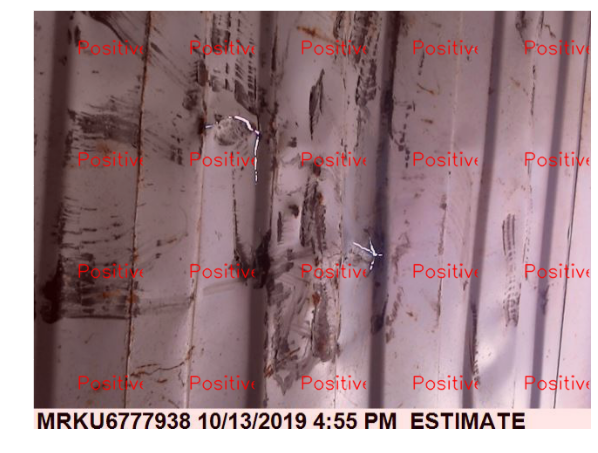

In [34]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_10.jpg', 128, 128)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 10.5 s, sys: 2.55 s, total: 13.1 s
Wall time: 6.55 s


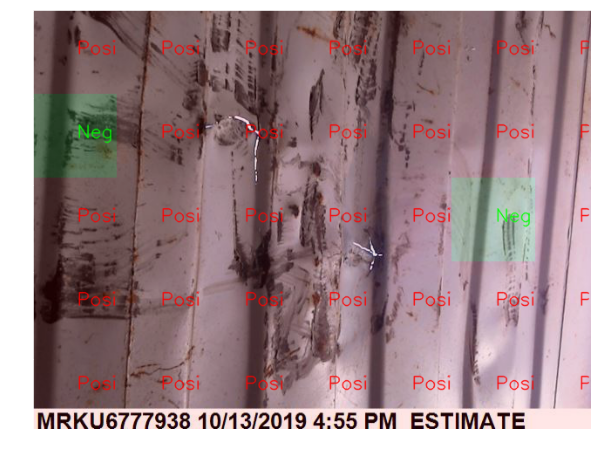

In [36]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_10.jpg', 96, 96)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 25.2 s, sys: 5.95 s, total: 31.2 s
Wall time: 15.6 s


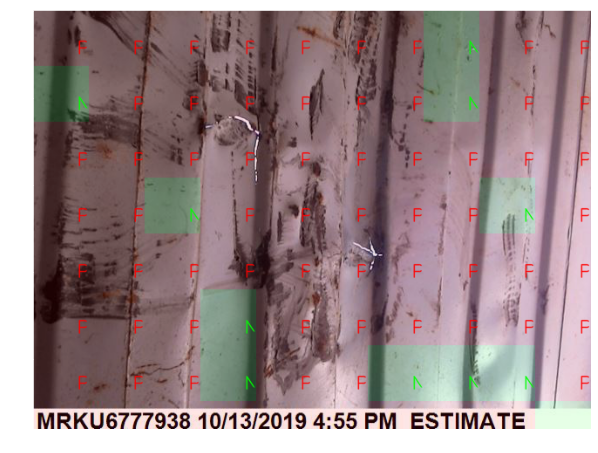

In [37]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_10.jpg', 64, 64)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 1min 41s, sys: 25.3 s, total: 2min 7s
Wall time: 1min 4s


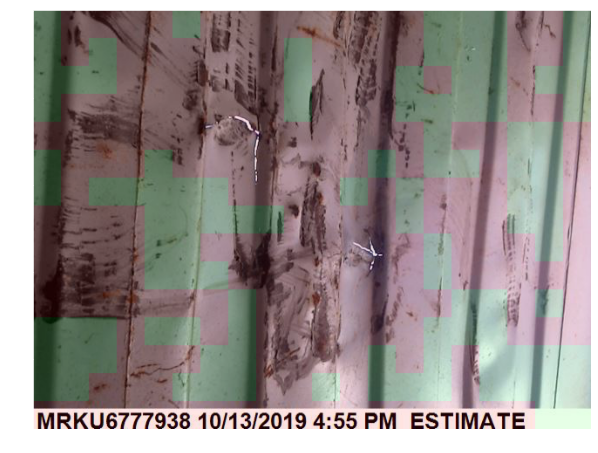

In [38]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_10.jpg', 32, 32)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 6min 35s, sys: 1min 37s, total: 8min 12s
Wall time: 4min 7s


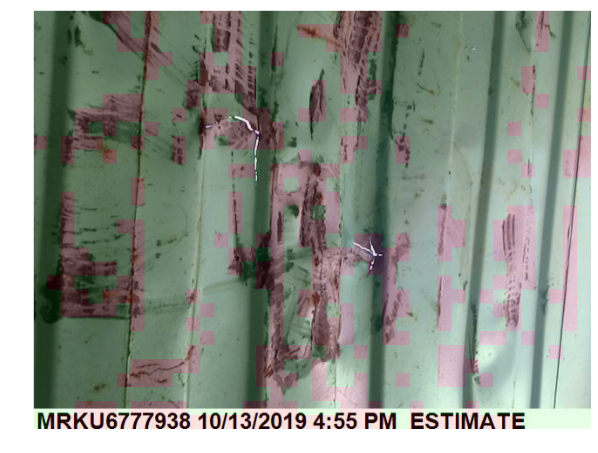

In [39]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_10.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 26min 14s, sys: 6min 29s, total: 32min 43s
Wall time: 16min 26s


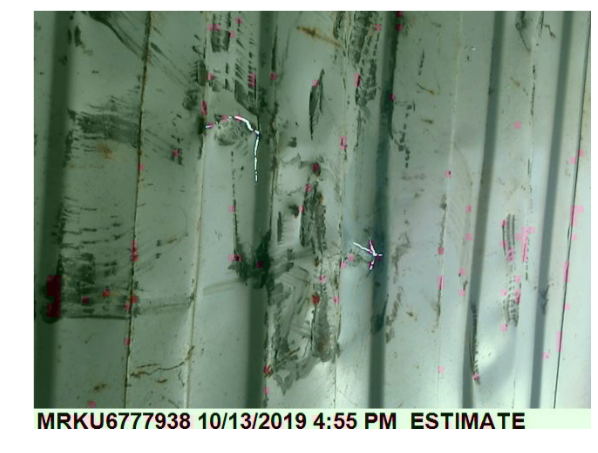

In [40]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_10.jpg', 8, 8)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 21min 37s, sys: 5min 26s, total: 27min 3s
Wall time: 13min 44s


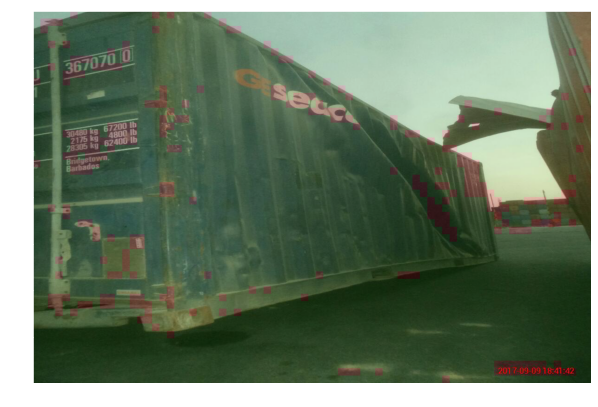

In [41]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_1.jpeg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 21min 43s, sys: 5min 21s, total: 27min 5s
Wall time: 13min 37s


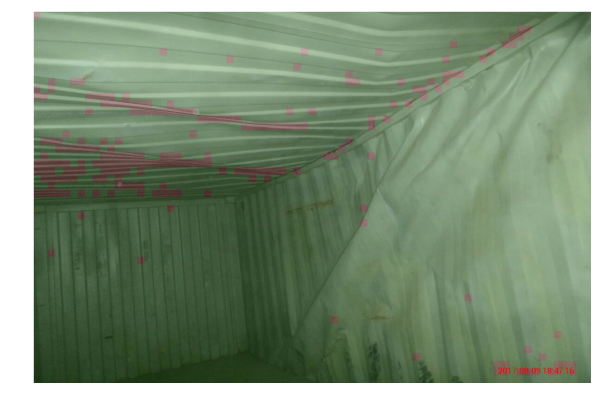

In [42]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_2.jpeg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 20min 19s, sys: 4min 58s, total: 25min 18s
Wall time: 12min 41s


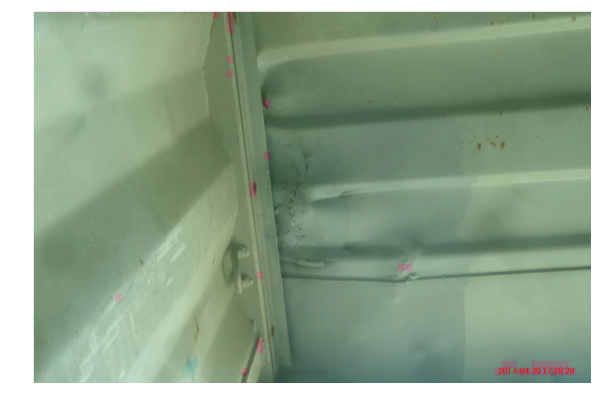

In [43]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_11.jpeg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 13min 1s, sys: 3min 12s, total: 16min 14s
Wall time: 8min 8s


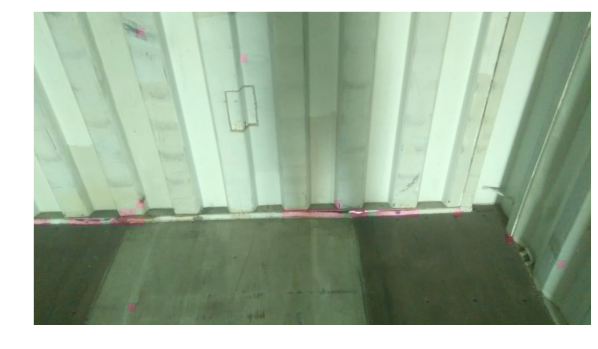

In [44]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_12.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 13min 7s, sys: 3min 16s, total: 16min 24s
Wall time: 8min 13s


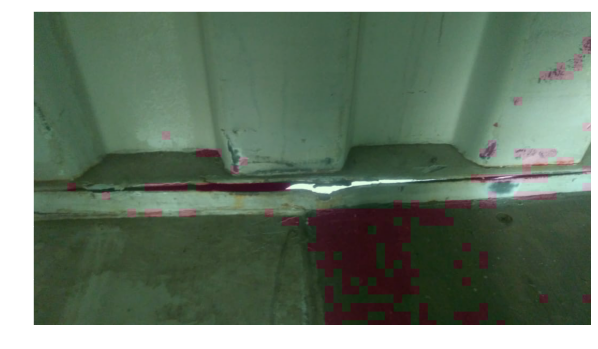

In [45]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_13.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 12min 56s, sys: 3min 13s, total: 16min 9s
Wall time: 8min 5s


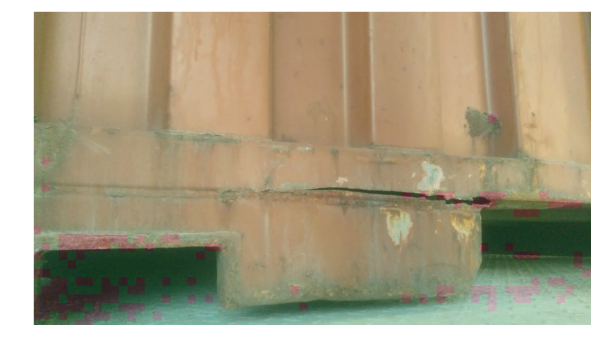

In [46]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_14.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 4h 43min 4s, sys: 1h 10min 44s, total: 5h 53min 48s
Wall time: 2h 57min 47s


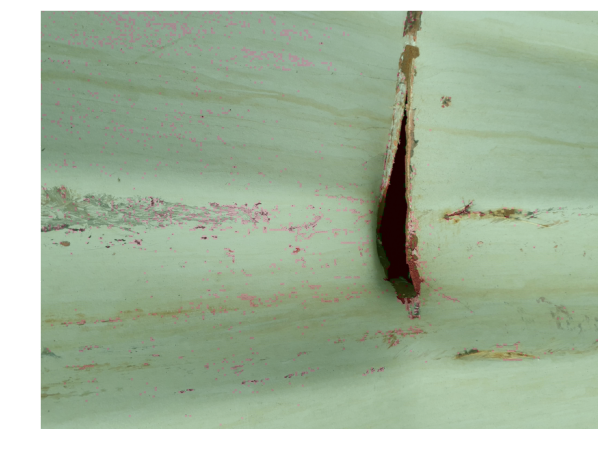

In [47]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_15.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 12min 29s, sys: 3min 6s, total: 15min 35s
Wall time: 7min 50s


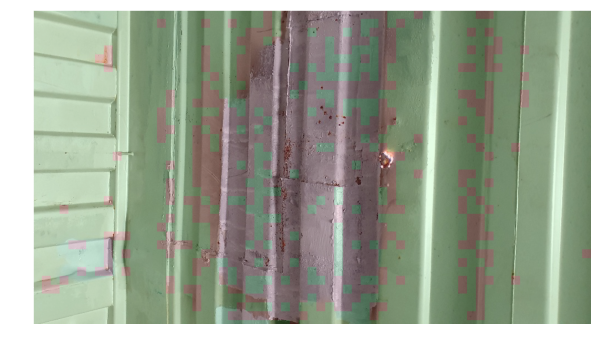

In [48]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_16.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 12min 35s, sys: 3min 7s, total: 15min 43s
Wall time: 7min 54s


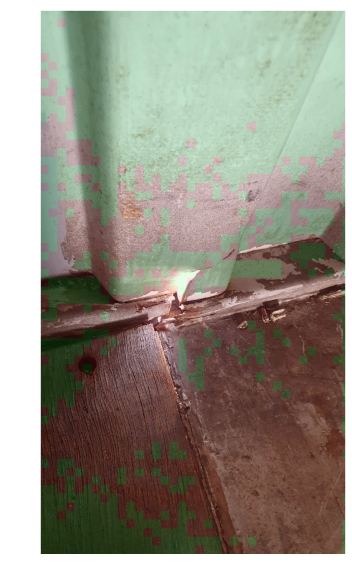

In [49]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_17.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 5h 35min 54s, sys: 1h 23min 27s, total: 6h 59min 21s
Wall time: 3h 30min 45s


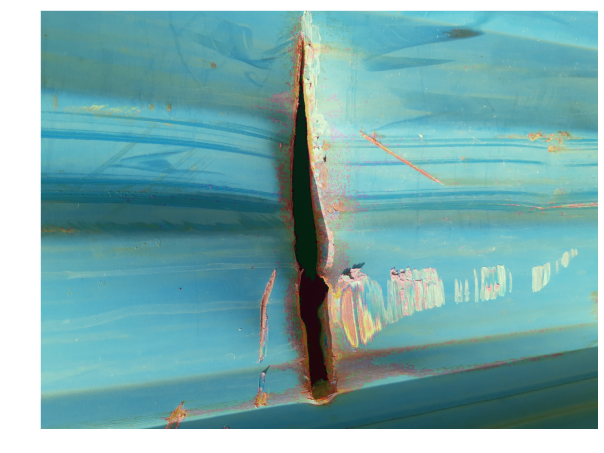

In [50]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_18.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 5h 11min 25s, sys: 1h 16min 23s, total: 6h 27min 48s
Wall time: 3h 14min 10s


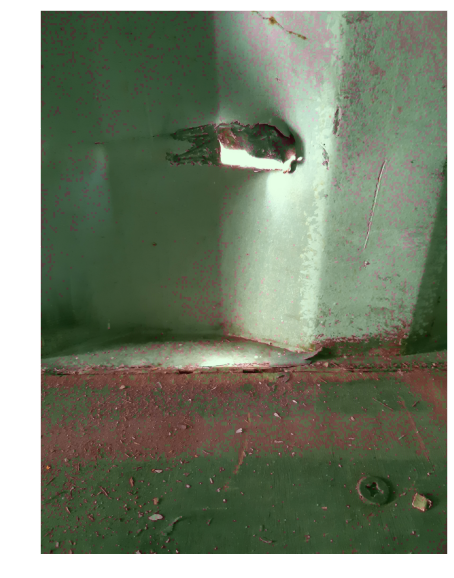

In [51]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_19.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 6min 1s, sys: 1min 29s, total: 7min 31s
Wall time: 3min 46s


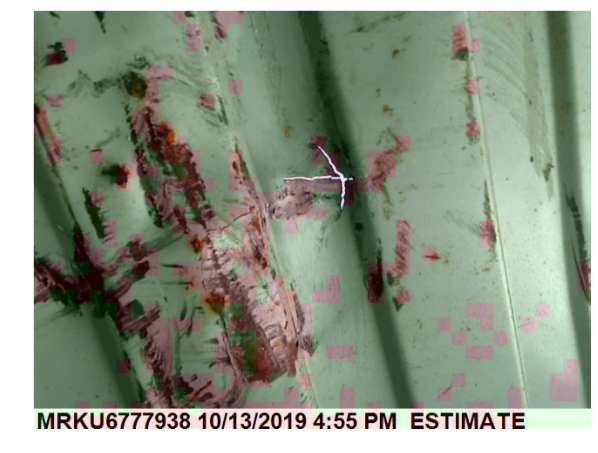

In [52]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_8.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 5h 35min 56s, sys: 1h 23min 16s, total: 6h 59min 13s
Wall time: 3h 30min 56s


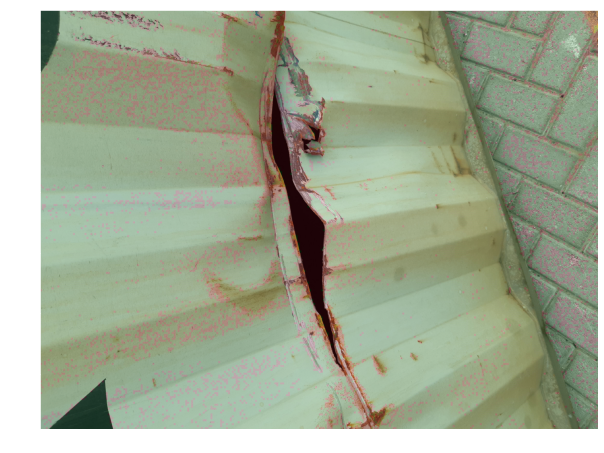

In [53]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_24.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 4h 3min 13s, sys: 59min 58s, total: 5h 3min 12s
Wall time: 2h 32min 5s


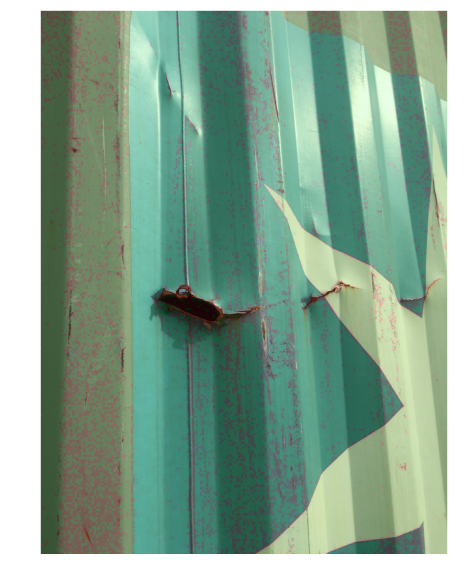

In [54]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/panel_damage_25.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 17min 25s, sys: 4min 20s, total: 21min 46s
Wall time: 10min 57s


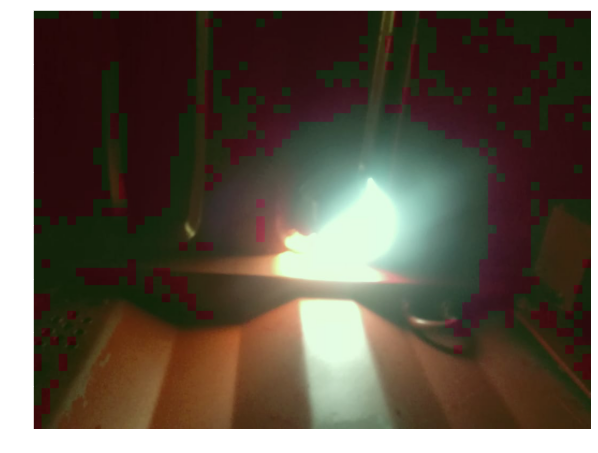

In [55]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/roof_damage_4.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 5h 19min 35s, sys: 1h 19min 19s, total: 6h 38min 54s
Wall time: 3h 20min 16s


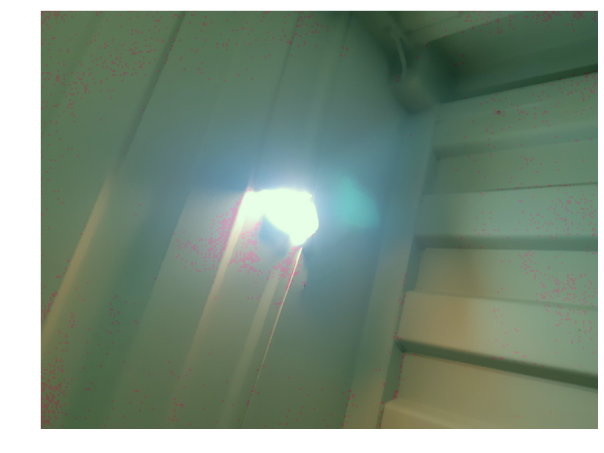

In [56]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/roof_damage_6.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 15min 33s, sys: 3min 51s, total: 19min 24s
Wall time: 9min 44s


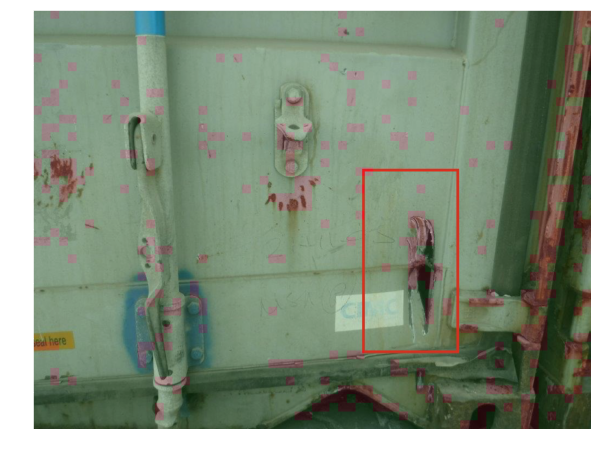

In [57]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/door_damage_2.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 16min 38s, sys: 4min 13s, total: 20min 52s
Wall time: 10min 32s


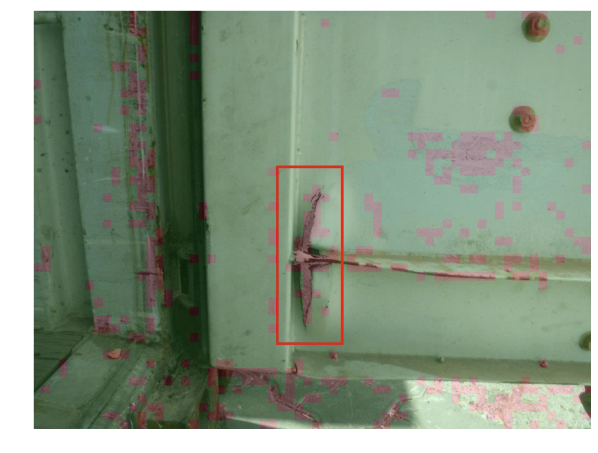

In [58]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/door_damage_3.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 21min 48s, sys: 5min 29s, total: 27min 17s
Wall time: 13min 51s


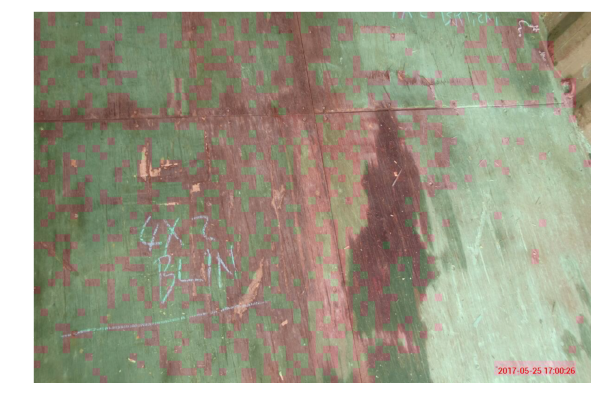

In [74]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/floor_damage_9.jpeg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 14min 49s, sys: 3min 38s, total: 18min 27s
Wall time: 9min 14s


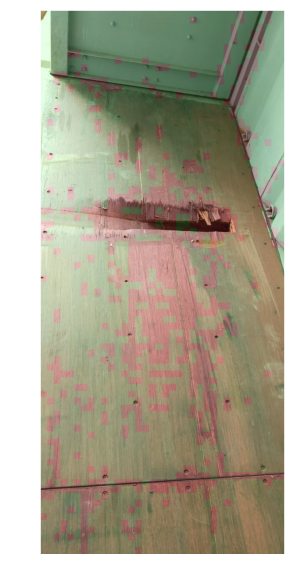

In [69]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/floor_damage_13.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 14min 49s, sys: 3min 36s, total: 18min 26s
Wall time: 9min 14s


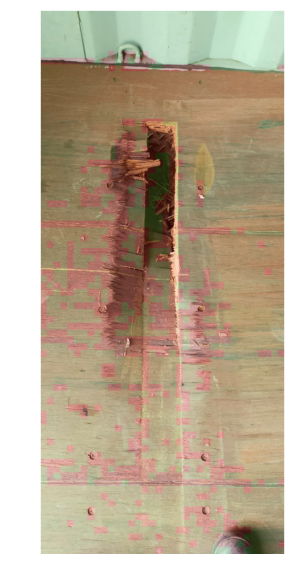

In [70]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/floor_damage_14.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 16min 23s, sys: 4min 3s, total: 20min 26s
Wall time: 10min 14s


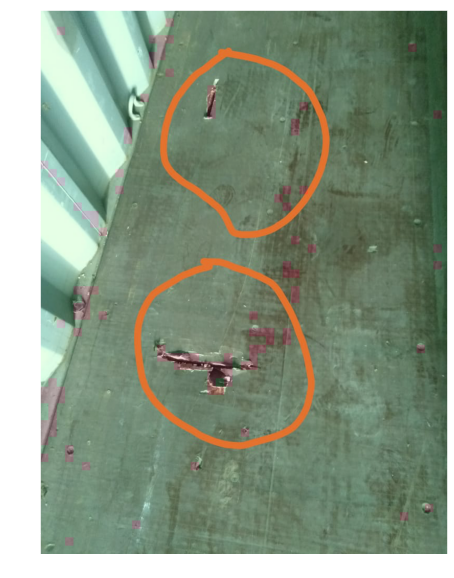

In [71]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/floor_damage_43.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))

CPU times: user 4h 23min 49s, sys: 1h 5min 23s, total: 5h 29min 13s
Wall time: 2h 45min 6s


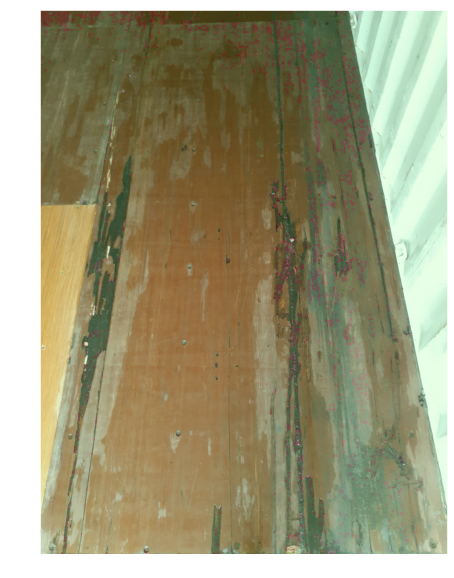

In [72]:
%%time
plt.figure(figsize=(10,10))
output_image = predict_on_crops('Images/floor_good_16.jpg', 16, 16)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))